# Navier-Stokes: Fluid Dynamic Simulation

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import imageio
import base64
from IPython.display import HTML, display

In [2]:
def run_navier_stokes_simulation(Lx, Ly, nx, ny, nu, rho, dt, nt, u_initial, v_initial, p_initial, save_steps=1):
   
    dx = Lx / (nx - 1)
    dy = Ly / (ny - 1)
    u = u_initial.copy()
    v = v_initial.copy()
    p = p_initial.copy()
    
    # Initialize outputs for visualization
    output_data = {
        'u': [],  # List to store u velocity fields
        'v': [],  # List to store v velocity fields
        'Lx': Lx, 'Ly': Ly, 'nx': nx, 'ny': ny  # Domain parameters
    }
    def pressure_poisson(p, dx, dy, rho, u, v):
        pn = np.empty_like(p)
        for _ in range(50):
            pn = p.copy()
            p[1:-1, 1:-1] = (((pn[1:-1, 2:] + pn[1:-1, :-2]) * dy**2 +
                             (pn[2:, 1:-1] + pn[:-2, 1:-1]) * dx**2) /
                            (2 * (dx**2 + dy**2)) -
                            dx**2 * dy**2 / (2 * (dx**2 + dy**2)) *
                            rho * ((1 / (2 * dx) * (u[1:-1, 2:] - u[1:-1, :-2])) +
                                   (1 / (2 * dy) * (v[2:, 1:-1] - v[:-2, 1:-1]))**2))
            p[:, -1] = p[:, -2]
            p[0, :] = p[1, :]
            p[:, 0] = p[:, 1]
            p[-1, :] = 0
        return p

    for n in range(nt):
        un = u.copy()
        vn = v.copy()

        p = pressure_poisson(p, dx, dy, rho, u, v)

        u[1:-1, 1:-1] = (un[1:-1, 1:-1] - un[1:-1, 1:-1] * dt / dx * (un[1:-1, 1:-1] - un[1:-1, :-2]) -
                         vn[1:-1, 1:-1] * dt / dy * (un[1:-1, 1:-1] - un[:-2, 1:-1]) -
                         dt / (2 * rho * dx) * (p[1:-1, 2:] - p[1:-1, :-2]) +
                         nu * (dt / dx**2 * (un[1:-1, 2:] - 2 * un[1:-1, 1:-1] + un[1:-1, :-2]) +
                               dt / dy**2 * (un[2:, 1:-1] - 2 * un[1:-1, 1:-1] + un[:-2, 1:-1])))

        v[1:-1, 1:-1] = (vn[1:-1, 1:-1] - un[1:-1, 1:-1] * dt / dx * (vn[1:-1, 1:-1] - vn[1:-1, :-2]) -
                         vn[1:-1, 1:-1] * dt / dy * (vn[1:-1, 1:-1] - vn[:-2, 1:-1]) -
                         dt / (2 * rho * dy) * (p[2:, 1:-1] - p[:-2, 1:-1]) +
                         nu * (dt / dx**2 * (vn[1:-1, 2:] - 2 * vn[1:-1, 1:-1] + vn[1:-1, :-2]) +
                               dt / dy**2 * (vn[2:, 1:-1] - 2 * vn[1:-1, 1:-1] + vn[:-2, 1:-1])))

        u[0, :] = 0
        u[:, 0] = 0
        u[:, -1] = 0
        u[-1, :] = 1
        v[0, :] = 0
        v[-1, :] = 0
        v[:, 0] = 0
        v[:, -1] = 0
        
        # Instead of capturing frames:
        if n % save_steps == 0:
            output_data['u'].append(u.copy())
            output_data['v'].append(v.copy())
    
    # Return the raw outputs for later visualization
    return output_data

def display_navier_stokes_as_gif(simulation_output, filename='navier_stokes_simulation.gif'):
    Lx = simulation_output['Lx']
    Ly = simulation_output['Ly']
    nx = simulation_output['nx']
    ny = simulation_output['ny']
    u_outputs = simulation_output['u']
    v_outputs = simulation_output['v']
    
    X, Y = np.linspace(0, Lx, nx), np.linspace(0, Ly, ny)

    # Create figure and axes outside the loop
    fig, ax = plt.subplots(figsize=(6, 6))
    frames = []

    for n, (u, v) in enumerate(zip(u_outputs, v_outputs)):
        ax.clear()  # Clear previous streamplot
        speed = np.sqrt(u**2 + v**2)
        base_line_width = 0.5
        scaling_factor = 2.0
        linewidth = base_line_width + scaling_factor * speed / speed.max()

        strm = ax.streamplot(X, Y, u, v, color='blue', density=1.5, linewidth=linewidth)
        ax.set_title(f'Time step {n}')
        ax.set_xlabel('X')
        ax.set_ylabel('Y')

        # Convert the plot to an image array
        fig.canvas.draw()
        image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
        image = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
        
        frames.append(image)
    
    plt.close(fig)  # Close the figure after all frames are captured

    # Write frames to a GIF
    with imageio.get_writer(filename, mode='I', duration=0.1, loop=0) as writer:
        for frame in frames:
            writer.append_data(frame)

    # Optionally, display the GIF in the notebook
    with open(filename, 'rb') as file:
        data = file.read()
        data_url = 'data:image/gif;base64,' + base64.b64encode(data).decode()
    display(HTML(f'<img src="{data_url}" alt="Navier Stokes Simulation"/>'))

In [3]:
# Domain size and physical variables
Lx = 2.0  # domain length in the x direction
Ly = 2.0  # domain length in the y direction
nx = 41   # number of grid points in x direction
ny = 41   # number of grid points in y direction
dx = Lx / (nx - 1)  # grid spacing in x direction
dy = Ly / (ny - 1)  # grid spacing in y direction
nu = 0.1   # kinematic viscosity
rho = 1.0  # density (assumed constant)

# Time-stepping parameters
dt = 0.001  # time step size
nt = 200    # number of time steps

# Initial conditions
u_initial = np.zeros((ny, nx))  # x-velocity
v_initial = np.zeros((ny, nx))  # y-velocity
p_initial = np.zeros((ny, nx))  # pressure

# run simulation
solution1 = run_navier_stokes_simulation(
    Lx, Ly, nx, ny, nu, rho, dt, nt, u_initial, v_initial, p_initial, 
    save_steps=2
)

/var/folders/vy/vr0_ytms6m95qrnk7xnh0bth0000gq/T/ipykernel_45842/113506177.py:94: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed two minor releases later. Use buffer_rgba instead.
  image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')



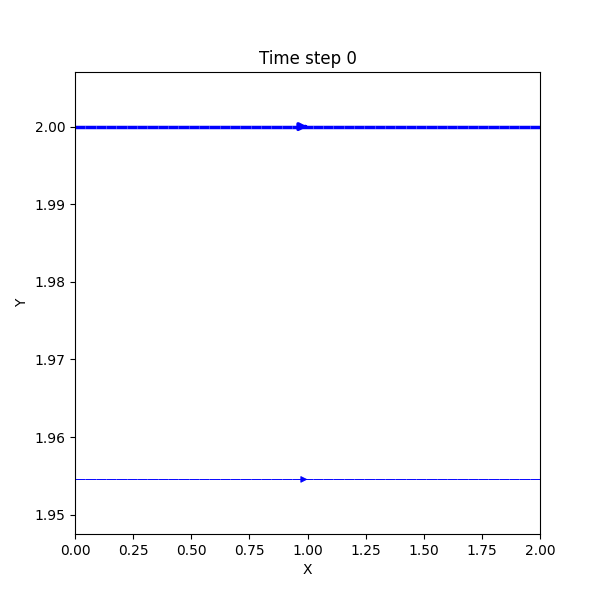

In [4]:
# display gif
display_navier_stokes_as_gif(solution1)

In [5]:
# Initialize a complex velocity field with multiple vortex centers
def initialize_complex_motion(nx, ny, centers, radii, strengths):
    u_initial = np.zeros((ny, nx))
    v_initial = np.zeros((ny, nx))
    epsilon = 1e-10  # Small number to prevent division by zero
    for center, radius, strength in zip(centers, radii, strengths):
        for i in range(nx):
            for j in range(ny):
                dx = i - center[0]
                dy = j - center[1]
                distance = np.sqrt(dx**2 + dy**2)
                if distance < radius and distance > epsilon:  # Ensure distance is not zero
                    u_initial[j, i] += -strength * (dy / distance)
                    v_initial[j, i] += strength * (dx / distance)
    return u_initial, v_initial

# Domain size and physical variables
Lx, Ly = 2.0, 2.0
nx, ny = 41, 41
nu = 0.1  # Kinematic viscosity
rho = 1.0  # Density
dt = 0.0001  # Time step size
nt = 100  # Number of time steps

# Initial conditions for more interesting dynamics
centers = [(nx // 3, ny // 3), (2 * nx // 3, 2 * ny // 3)]  # Two centers for circular motion
radii = [min(nx, ny) // 6, min(nx, ny) // 6]  # Radii of the motions
strengths = [5.0, -5.0]  # Opposite strengths for creating interacting vortexes
u_initial, v_initial = initialize_complex_motion(nx, ny, centers, radii, strengths)
p_initial = np.zeros((ny, nx))  # Initially uniform pressure

# Run the simulation with the specified parameters and initial conditions
solution2 = run_navier_stokes_simulation(Lx, Ly, nx, ny, nu, rho, dt, nt, u_initial, v_initial, p_initial, save_steps=10)

/var/folders/vy/vr0_ytms6m95qrnk7xnh0bth0000gq/T/ipykernel_45842/113506177.py:94: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed two minor releases later. Use buffer_rgba instead.
  image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')



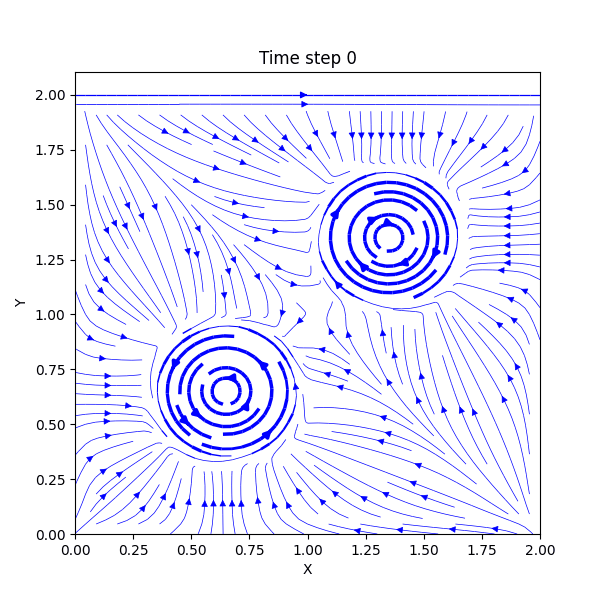

In [6]:
# Generate and display the GIF using the simulation output
display_navier_stokes_as_gif(solution2)

In [7]:
# Domain size and physical variables
Lx, Ly = 2.0, 2.0
nx, ny = 101, 101  # Increased resolution for better detail
dx, dy = Lx / (nx - 1), Ly / (ny - 1)
nu = 0.01  # Kinematic viscosity
rho = 1.0  # Density
dt = 0.001  # Time step size
nt = 300  # Number of time steps to simulate
obstacle_x, obstacle_y = nx // 4, ny // 2  # Obstacle position
obstacle_size = nx // 15  # Size of the obstacle

u_initial = np.zeros((ny, nx))
v_initial = np.zeros((ny, nx))
p_initial = np.zeros((ny, nx))

# Initialize flow to move from left to right
u_initial[:, :] = 1.0

# Insert the obstacle into the flow field
u_initial[obstacle_y - obstacle_size//2:obstacle_y + obstacle_size//2,
          obstacle_x - obstacle_size//2:obstacle_x + obstacle_size//2] = 0
v_initial[obstacle_y - obstacle_size//2:obstacle_y + obstacle_size//2,
          obstacle_x - obstacle_size//2:obstacle_x + obstacle_size//2] = 0

# Run the simulation with the specified parameters and initial conditions
solution3 = run_navier_stokes_simulation(Lx, Ly, nx, ny, nu, rho, dt, nt, u_initial, v_initial, p_initial, save_steps=2)

/var/folders/vy/vr0_ytms6m95qrnk7xnh0bth0000gq/T/ipykernel_45842/113506177.py:94: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed two minor releases later. Use buffer_rgba instead.
  image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')



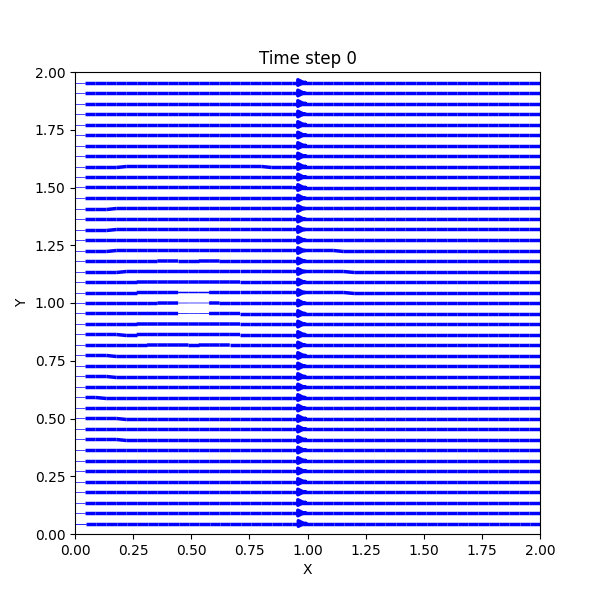

In [8]:
# Generate and display the GIF using the simulation output
display_navier_stokes_as_gif(solution3)

In [9]:
def initialize_flow_with_obstacle_and_flux(nx, ny, Lx, Ly):
    """Initialize velocity fields with an obstacle and approximate a sinking flux effect."""
    # Initialize velocity and pressure fields
    u_initial = np.zeros((ny, nx))
    v_initial = np.zeros((ny, nx))
    p_initial = np.zeros((ny, nx))

    # Obstacle parameters (centered with a radius)
    cx, cy = Lx / 2, Ly / 2
    radius = min(Lx, Ly) / 10
    obstacle_indices = []

    for i in range(nx):
        for j in range(ny):
            x = i * (Lx / (nx - 1))
            y = j * (Ly / (ny - 1))
            # Blocking flow at the obstacle
            if (x - cx)**2 + (y - cy)**2 < radius**2:
                u_initial[j, i] = 0
                v_initial[j, i] = 0
            else:
                u_initial[j, i] = 1  # Initial flow from left to right outside the obstacle
                
            # Adding sinking flux effect near the center
            if (x - cx)**2 + (y - cy)**2 < (radius / 2)**2:
                v_initial[j, i] -= 2  # Negative for downward
                
    return u_initial, v_initial, p_initial

# def apply_sinking_flux(v, nx, ny, strength=-0.5):
#     """Apply a sinking flux at the center of the obstacle."""
#     center_x, center_y = nx // 2, ny // 2  # Center of the domain
#     radius = min(nx, ny) // 20  # Smaller radius for concentrated sinking effect

#     # Apply vertical sinking flux near the center of the obstacle
#     for i in range(nx):
#         for j in range(ny):
#             if (i - center_x)**2 + (j - center_y)**2 < radius**2:
#                 v[j, i] += strength  # Apply sinking strength

#     return v

In [16]:
# Simulation parameters
Lx, Ly = 2.0, 2.0
nx, ny = 101, 101
nu = 0.01
rho = 1.0
dt = 0.00001
nt = 1000
save_steps = 10

# Initialize the flow with an obstacle and a simulated sinking flux
u_initial, v_initial, p_initial = initialize_flow_with_obstacle_and_flux(nx, ny, Lx, Ly)

# Assuming the run_navier_stokes_simulation function is defined to handle these inputs
solution4 = run_navier_stokes_simulation(Lx, Ly, nx, ny, nu, rho, dt, nt, u_initial, v_initial, p_initial, save_steps)

/var/folders/vy/vr0_ytms6m95qrnk7xnh0bth0000gq/T/ipykernel_45842/113506177.py:94: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed two minor releases later. Use buffer_rgba instead.
  image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')



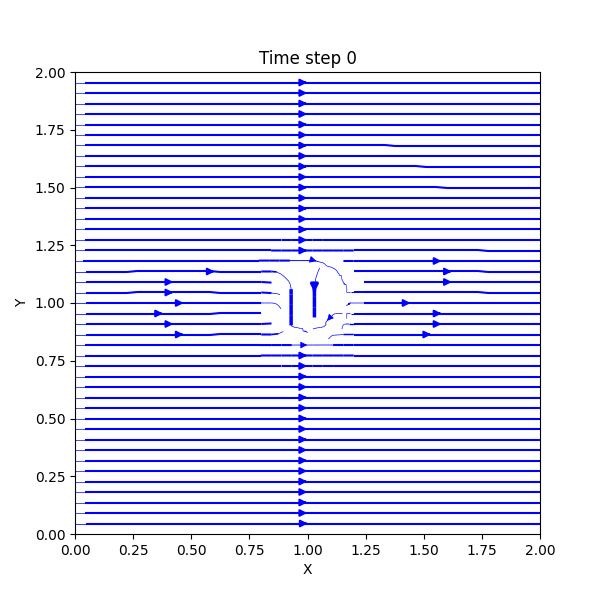

In [17]:
# Generate and display the GIF using the simulation output
display_navier_stokes_as_gif(solution4)